In [14]:
import cv2 as cv
import numpy as np
from google.colab.patches import cv2_imshow
import glob

In [15]:
# Input images
!wget https://www.dropbox.com/s/pl124wv419wy3q4/dog.jpg?dl=0 -O dog.jpg
!wget https://www.dropbox.com/s/lm2j2wsxoauriug/person.jpg?dl=0 -O person.jpg
!wget https://www.dropbox.com/s/3h4kl3pbawinuno/12283150_12d37e6389_z.jpg?dl=0 -O 12283150_12d37e6389_z.jpg
!wget https://www.dropbox.com/s/appx68awdsrtac7/000000439715.jpg?dl=0 -O 000000439715.jpg

--2021-06-05 14:03:44--  https://www.dropbox.com/s/pl124wv419wy3q4/dog.jpg?dl=0
Resolving www.dropbox.com (www.dropbox.com)... 162.125.80.18, 2620:100:6016:18::a27d:112
Connecting to www.dropbox.com (www.dropbox.com)|162.125.80.18|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/pl124wv419wy3q4/dog.jpg [following]
--2021-06-05 14:03:45--  https://www.dropbox.com/s/raw/pl124wv419wy3q4/dog.jpg
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc6ef726d0ecb633d79d88ebd227.dl.dropboxusercontent.com/cd/0/inline/BP1iXrDwf6p4NoBdjGrKjBQlOn_mvvbvREwDTILxFkB1XH4fikSBrK2CmiCcxxHM2FcFWLO-3iuJetyLDL__ty9SNbSZic_xARaAiEdD_pOVyFIhxOV4ul2VY9RL1a06UjV3jobgneHCWX8i1tgaj9PZ/file# [following]
--2021-06-05 14:03:45--  https://uc6ef726d0ecb633d79d88ebd227.dl.dropboxusercontent.com/cd/0/inline/BP1iXrDwf6p4NoBdjGrKjBQlOn_mvvbvREwDTILxFkB1XH4fikSBrK2CmiCcxxHM2FcFWLO-3iuJetyLDL__ty9SNbSZic_xAR

In [16]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [17]:
# CNN model
classLabels = "object_detection_classes_coco.txt"
config = "mask_rcnn_inception_v2_coco_2018_01_28.pbtxt"
model  = "frozen_inference_graph.pb"
!wget https://www.dropbox.com/s/nta73ep3mrdbgtw/object_detection_classes_coco.txt?dl=0 -O object_detection_classes_coco.txt
!wget https://www.dropbox.com/s/sv14r9q5i6zyb4e/mask_rcnn_inception_v2_coco_2018_01_28.pbtxt?dl=0 -O mask_rcnn_inception_v2_coco_2018_01_28.pbtxt
!wget https://www.dropbox.com/s/22lfphy3xd2wtvq/frozen_inference_graph.pb?dl=0 -O frozen_inference_graph.pb

--2021-06-05 14:03:48--  https://www.dropbox.com/s/nta73ep3mrdbgtw/object_detection_classes_coco.txt?dl=0
Resolving www.dropbox.com (www.dropbox.com)... 162.125.1.18, 2620:100:6016:18::a27d:112
Connecting to www.dropbox.com (www.dropbox.com)|162.125.1.18|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/nta73ep3mrdbgtw/object_detection_classes_coco.txt [following]
--2021-06-05 14:03:48--  https://www.dropbox.com/s/raw/nta73ep3mrdbgtw/object_detection_classes_coco.txt
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://ucd2011cfed7564bad2885ed7156.dl.dropboxusercontent.com/cd/0/inline/BP3HJjIyPoC7IG-nU1O41ZkVbjj7-HFpDRuDiPmgcAYlYMFddcbOHrAX8X2xz0QkPJcd_7HymMHgR3w2LXuhUZUVcPTdaE7MhDIXr6bvCgIZifXxKb-WfM5fyycPqatXumCpVewUxVz2D5i6zS4rj4Fn/file# [following]
--2021-06-05 14:03:49--  https://ucd2011cfed7564bad2885ed7156.dl.dropboxusercontent.com/cd/0/inline/BP3HJjIyPoC7IG-nU1O41Z

In [18]:
# Parameters
TH1 = 0.55  # Confidence
TH2 = 0.35  # Mask  

In [19]:
def drawBox(frame, classId, conf, left, top, right, bottom):
    label = '%s: %.2f' % (classNames[classId], conf)
    print(label)

    # Draw a bounding box.
    cv.rectangle(frame, (left, top), (right, bottom), (0, 255, 0))
    labelSize, baseLine = cv.getTextSize(label, cv.FONT_HERSHEY_SIMPLEX, 0.5, 1)
    top = max(top, labelSize[1])
    cv.rectangle(frame, (left, top - labelSize[1]), (left + labelSize[0], top + baseLine), (255, 255, 255), cv.FILLED)
    cv.putText(frame, label, (left, top), cv.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 0))

In [20]:
if __name__ == "__main__":

    with open(classLabels, 'rt') as file:
        classNames = file.read().strip('\n').split('\n')
    np.random.seed(324)
    colors = np.random.uniform(0, 255, size=(len(classNames), 3))

car: 0.99


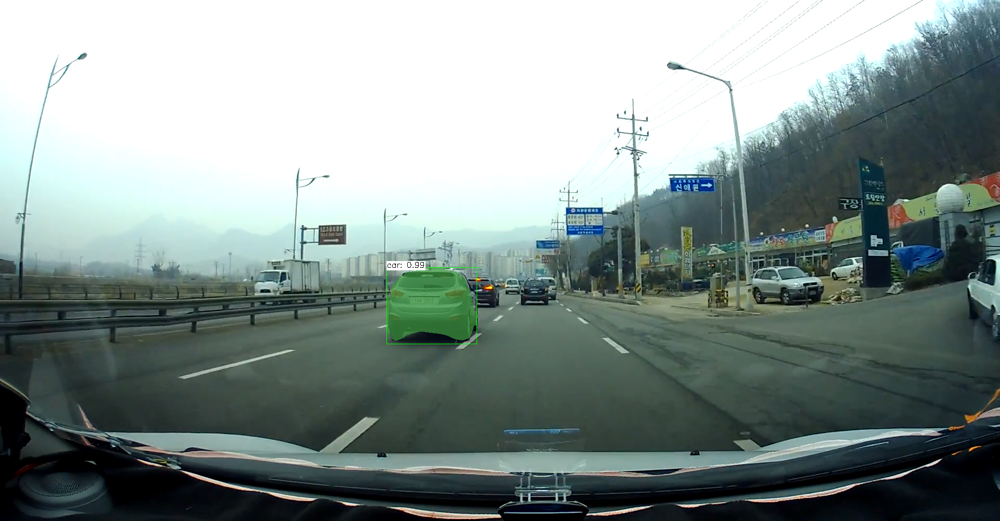

car: 0.99
car: 0.97


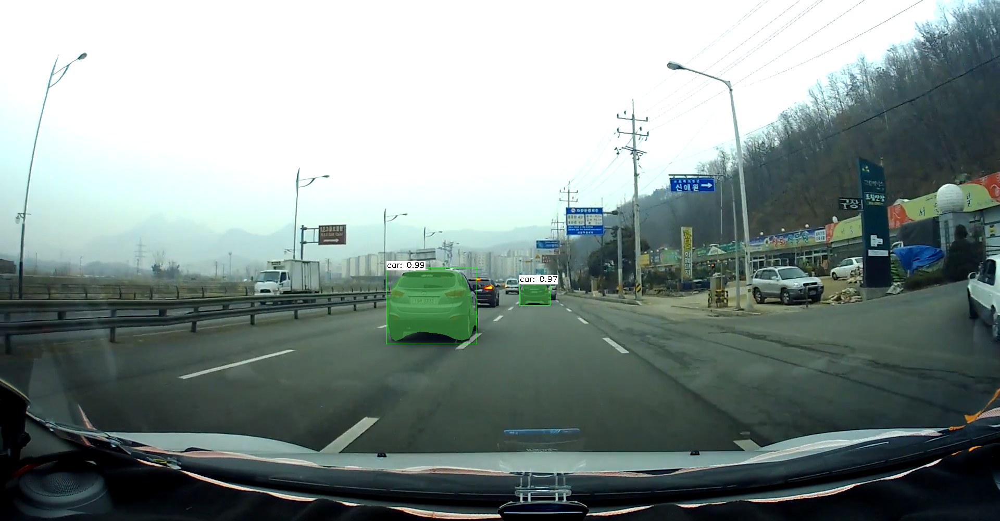

car: 0.99
car: 0.97
car: 0.97


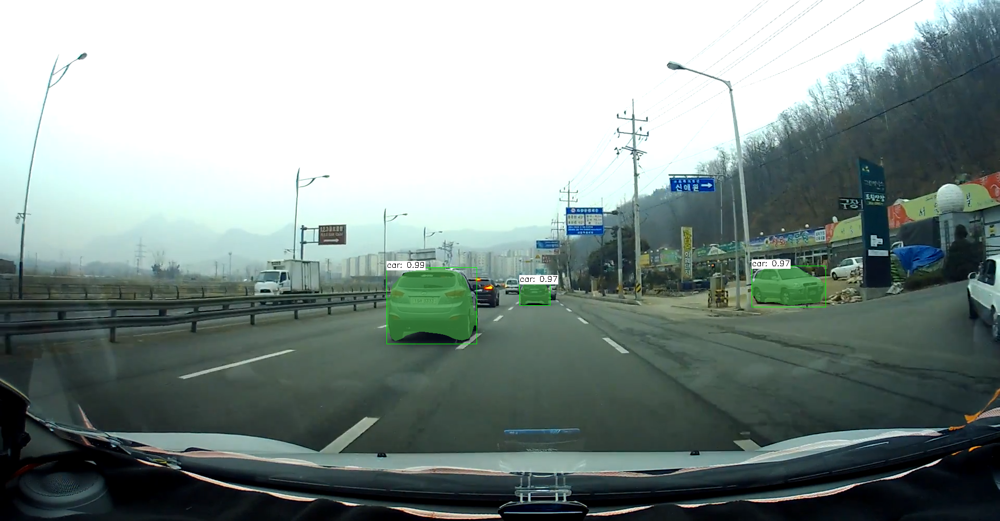

car: 0.99
car: 0.97
car: 0.97
truck: 0.96


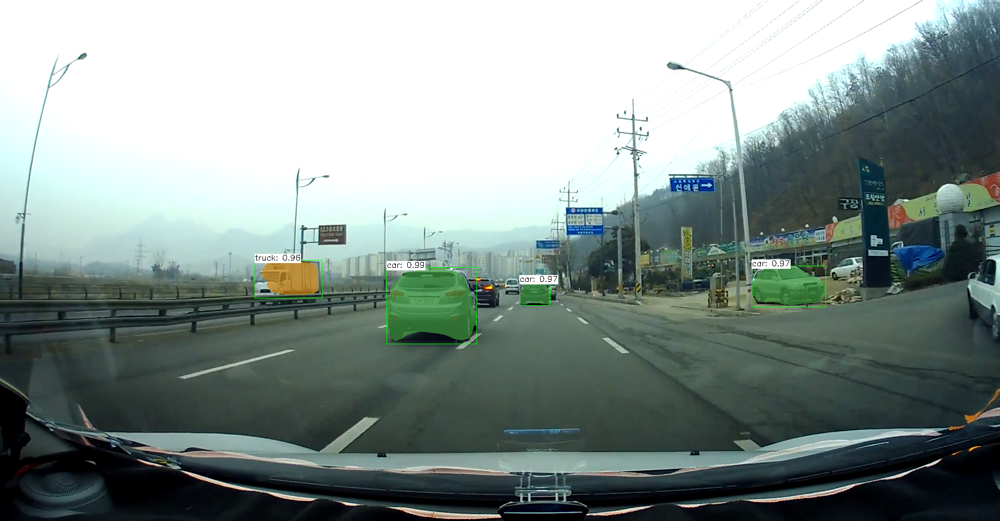

car: 0.99
car: 0.97
car: 0.97
truck: 0.96
car: 0.96


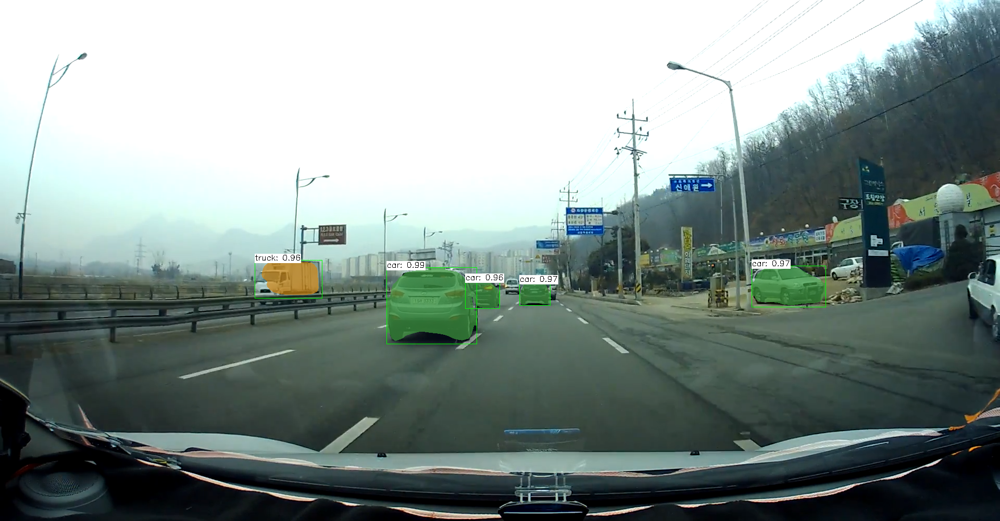

car: 0.99
car: 0.97
car: 0.97
truck: 0.96
car: 0.96
car: 0.95


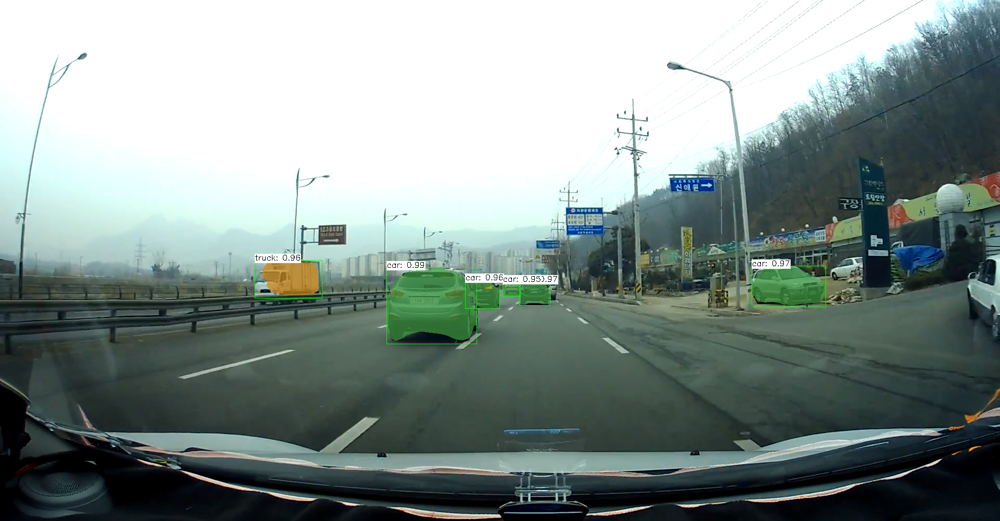

car: 0.99
car: 0.97
car: 0.97
truck: 0.96
car: 0.96
car: 0.95
car: 0.95


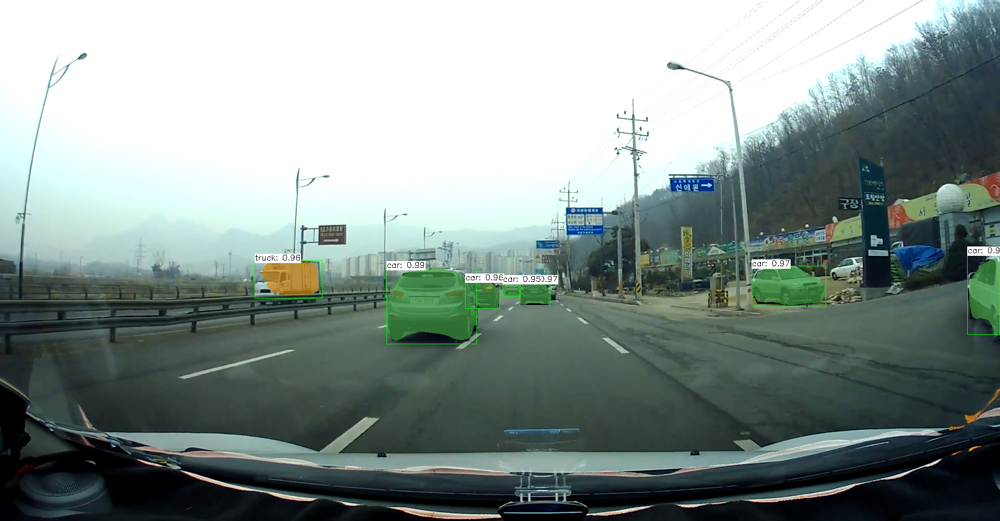

car: 0.99
car: 0.97
car: 0.97
truck: 0.96
car: 0.96
car: 0.95
car: 0.95
car: 0.89


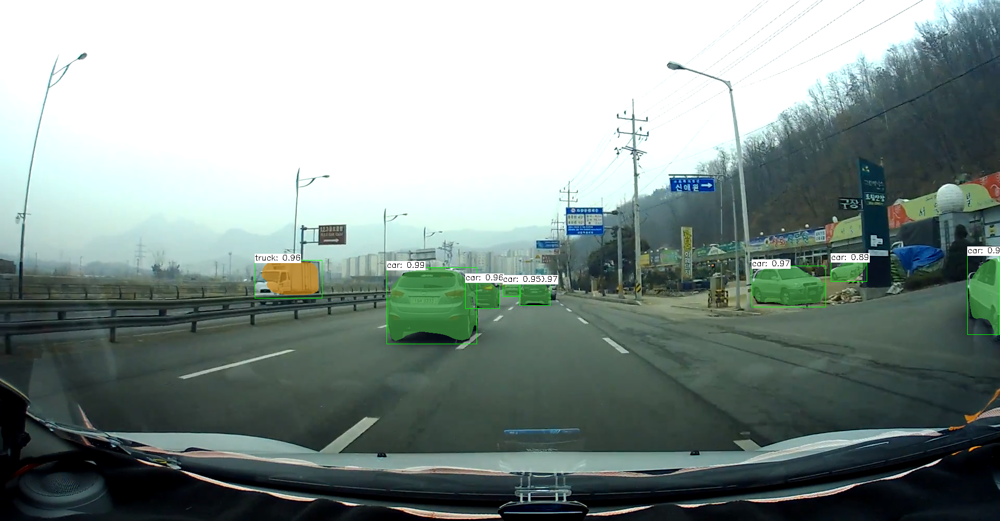

car: 0.99
car: 0.97
car: 0.97
truck: 0.96
car: 0.96
car: 0.95
car: 0.95
car: 0.89
person: 0.83


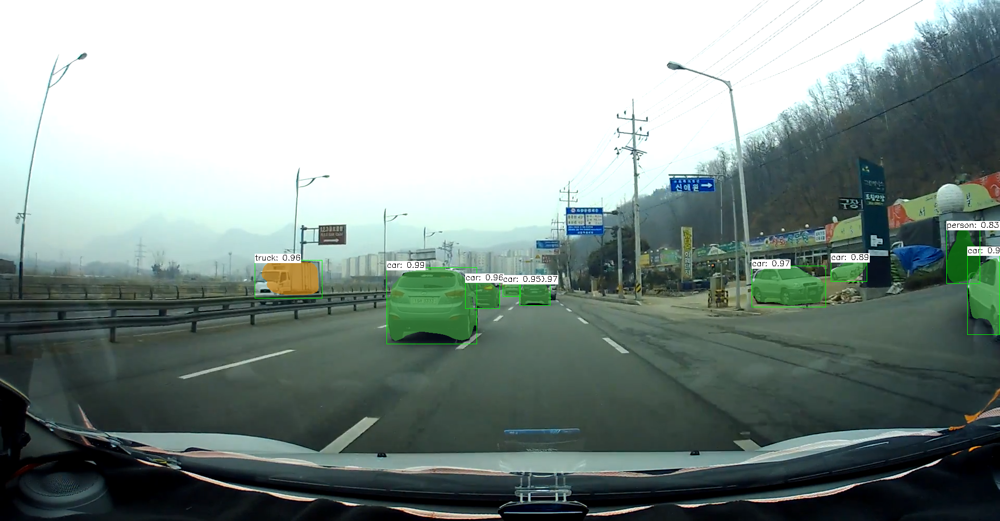

car: 0.99
car: 0.97
car: 0.97
truck: 0.96
car: 0.96
car: 0.95
car: 0.95
car: 0.89
person: 0.83
car: 0.77


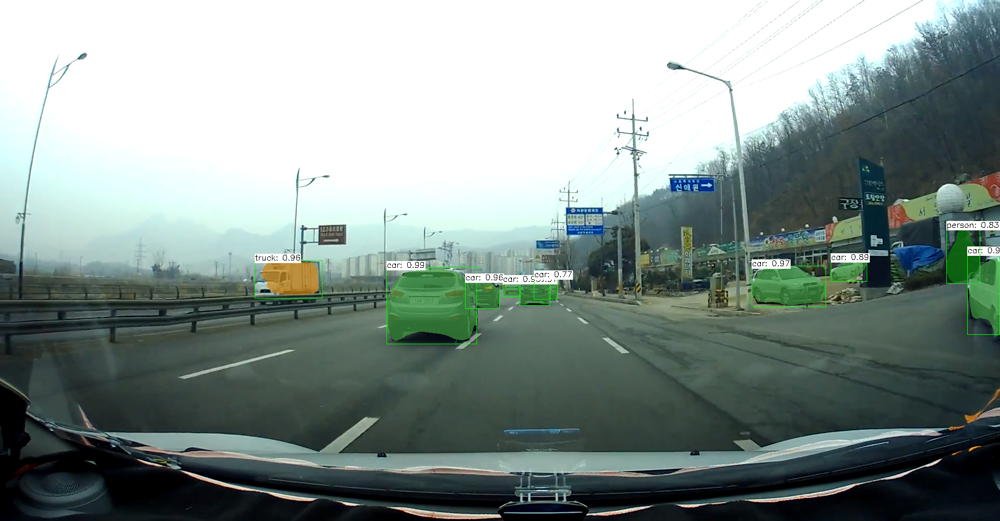

car: 0.99
car: 0.97
car: 0.97
truck: 0.96
car: 0.96
car: 0.95
car: 0.95
car: 0.89
person: 0.83
car: 0.77
airplane: 0.73


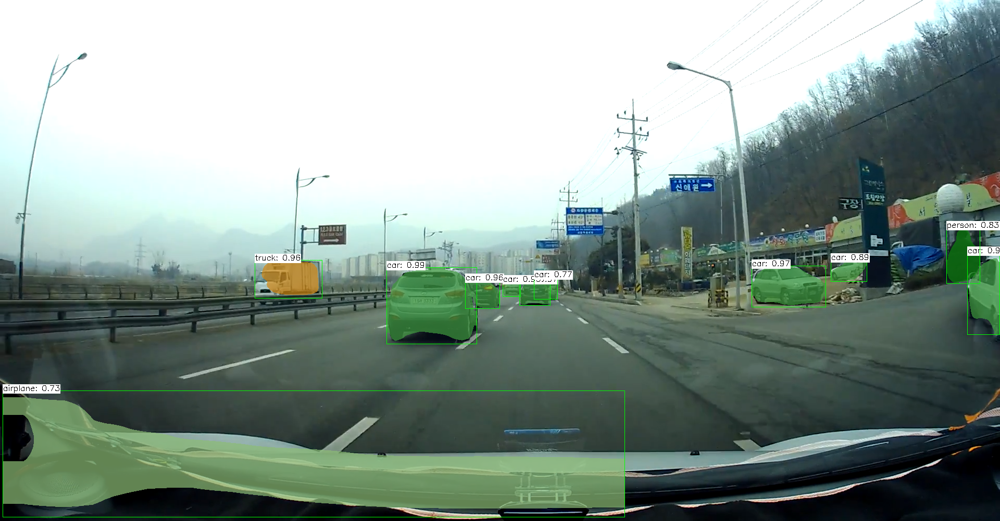

car: 0.99
car: 0.97
car: 0.97
truck: 0.96
car: 0.96
car: 0.95
car: 0.95
car: 0.89
person: 0.83
car: 0.77
airplane: 0.73
person: 0.59


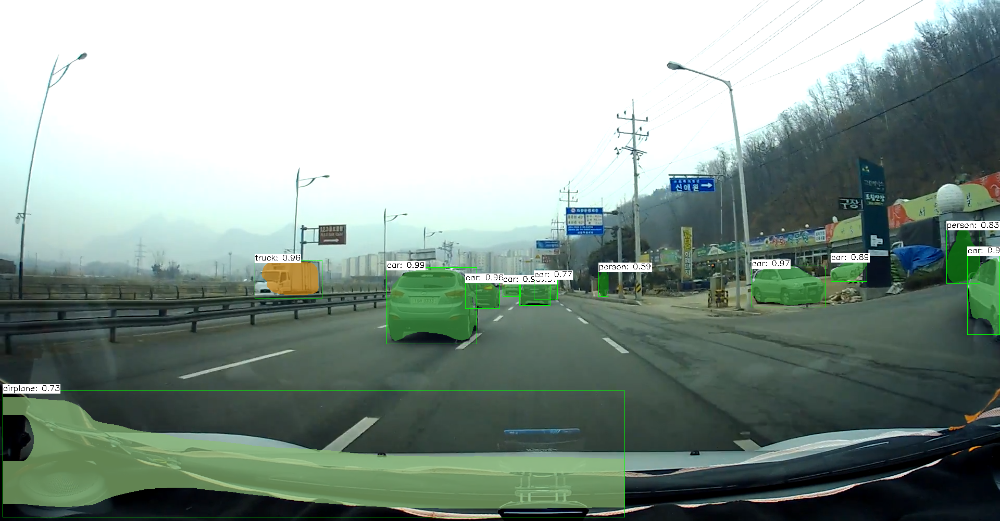

car: 0.99


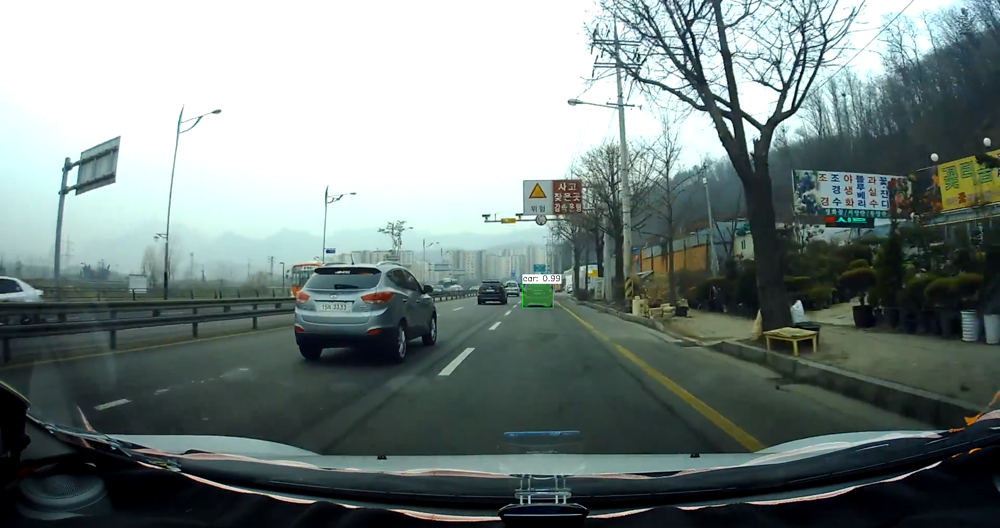

car: 0.99
car: 0.98


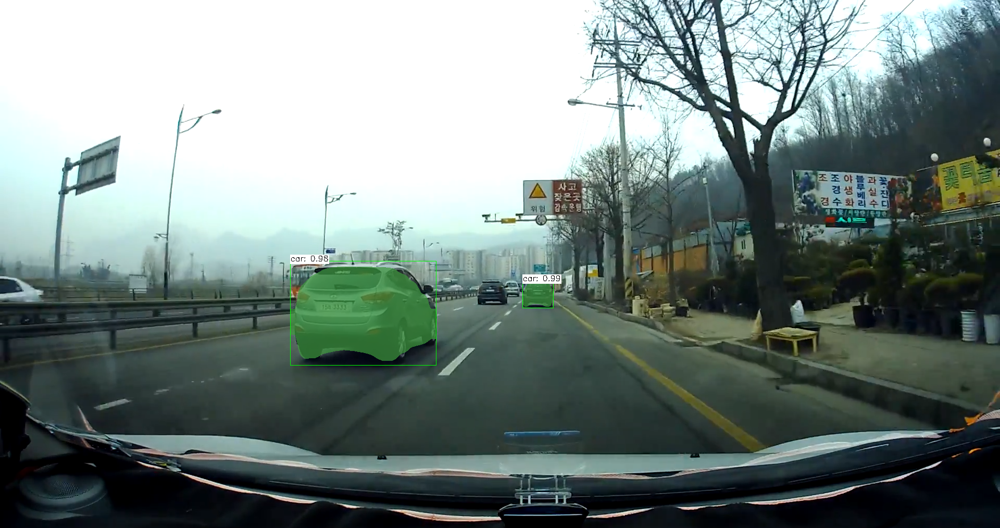

car: 0.99
car: 0.98
car: 0.97


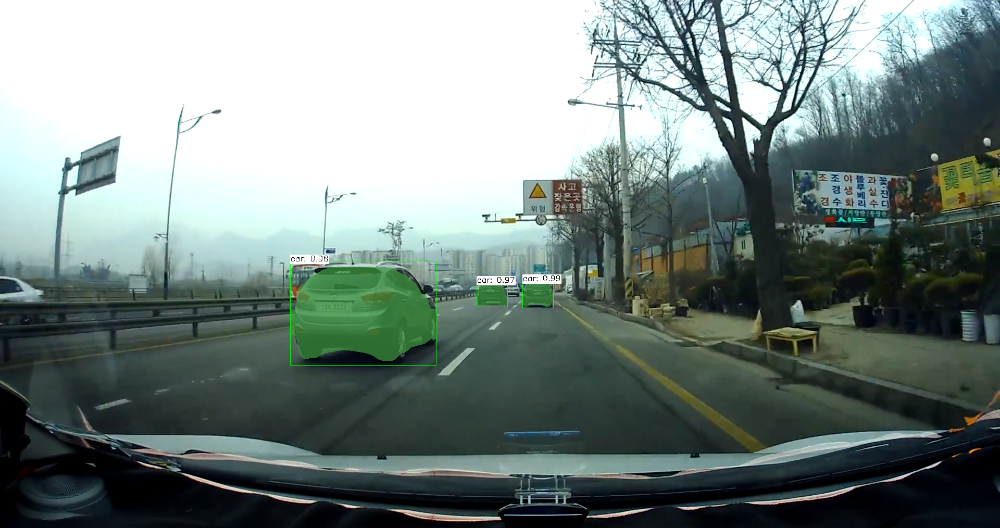

car: 0.99
car: 0.98
car: 0.97
car: 0.95


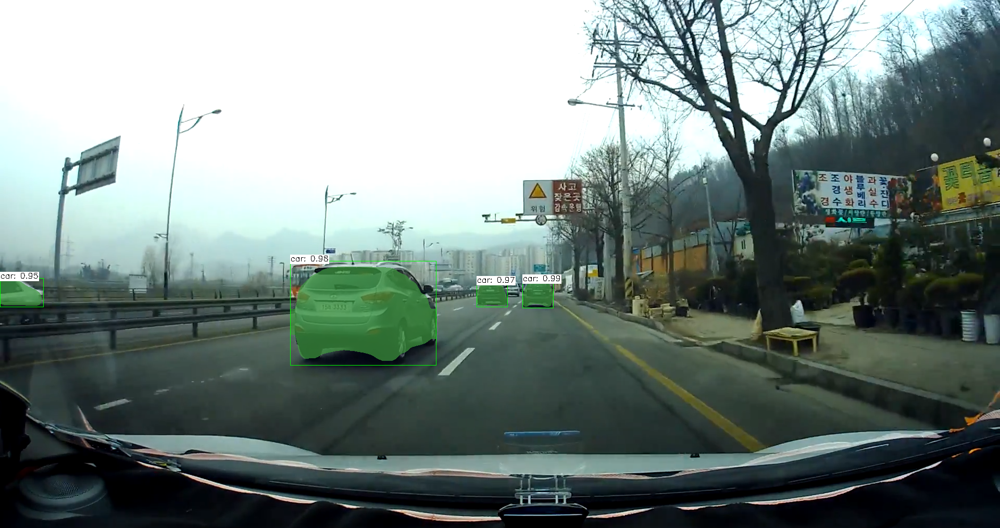

car: 0.99
car: 0.98
car: 0.97
car: 0.95
car: 0.90


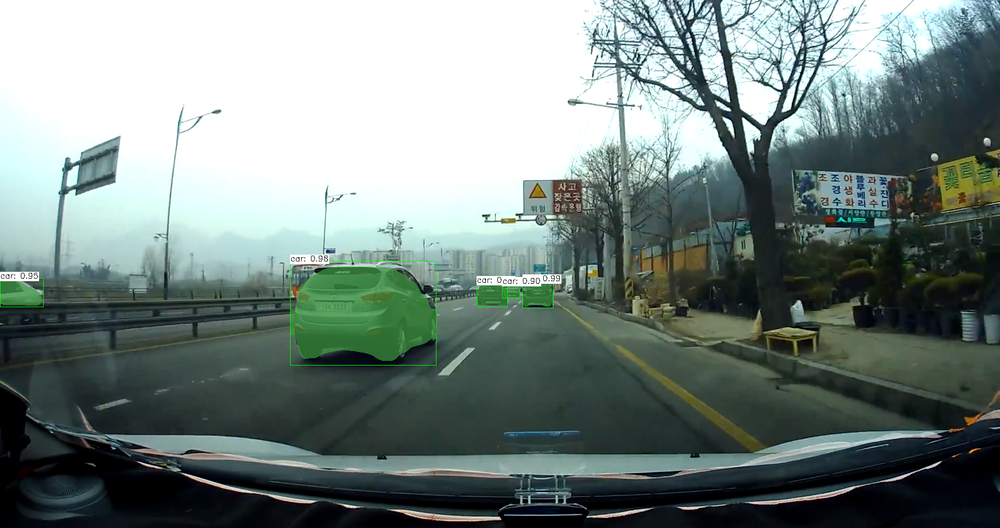

car: 0.99
car: 0.98
car: 0.97
car: 0.95
car: 0.90
airplane: 0.73


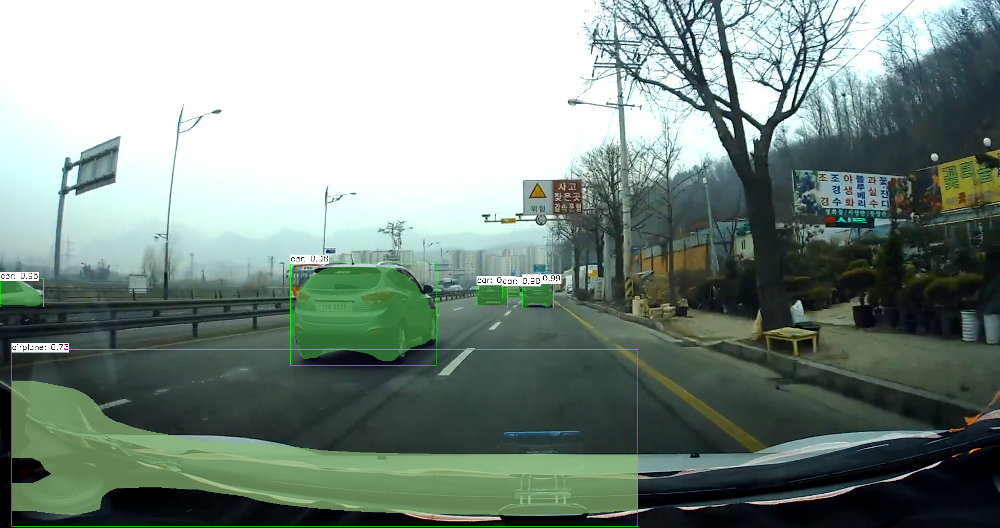

car: 0.99
car: 0.98
car: 0.97
car: 0.95
car: 0.90
airplane: 0.73
airplane: 0.56


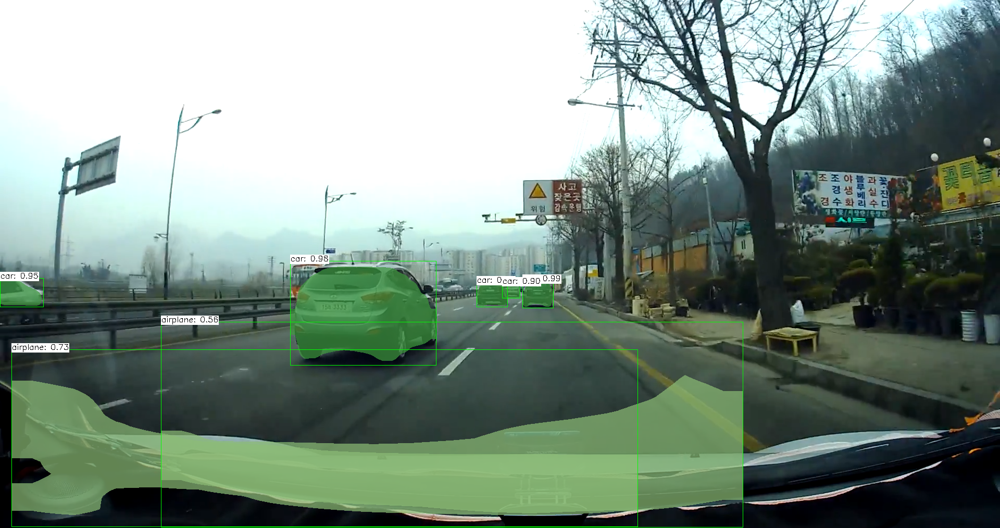

person: 0.98


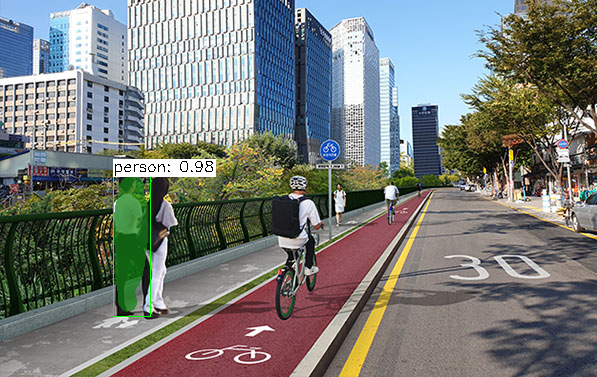

person: 0.98
person: 0.98


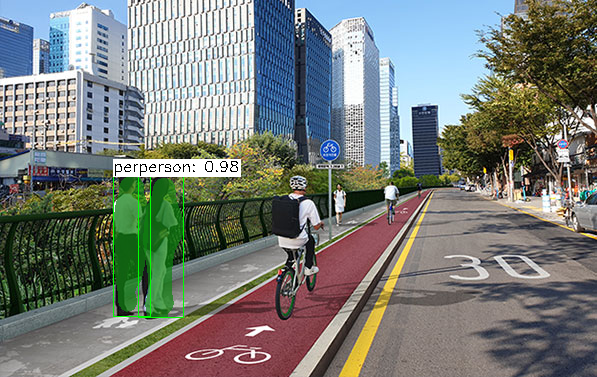

person: 0.98
person: 0.98
person: 0.95


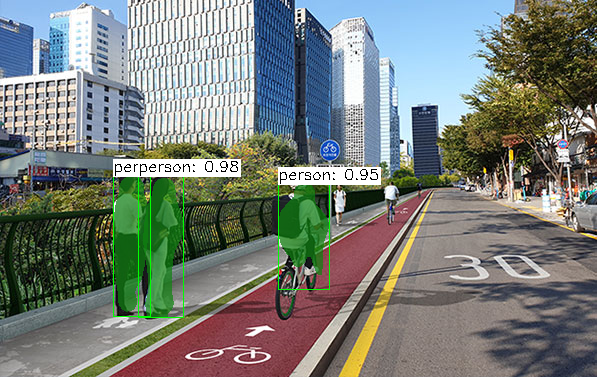

person: 0.98
person: 0.98
person: 0.95
bicycle: 0.93


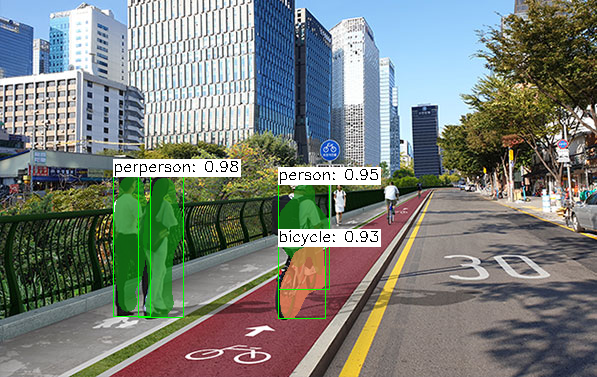

person: 0.98
person: 0.98
person: 0.95
bicycle: 0.93
person: 0.78


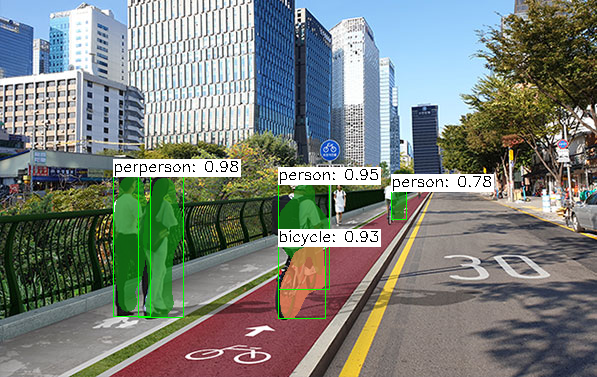

person: 0.98
person: 0.98
person: 0.95
bicycle: 0.93
person: 0.78
car: 0.71


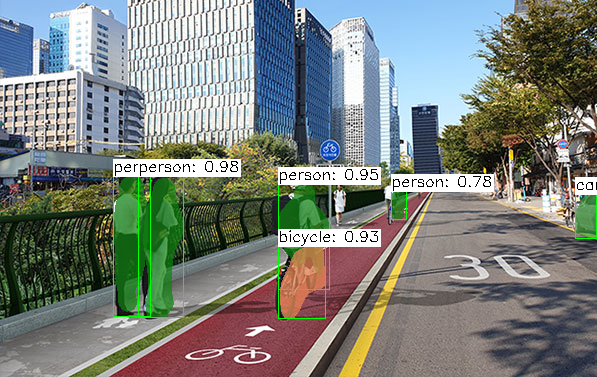

person: 0.98
person: 0.98
person: 0.95
bicycle: 0.93
person: 0.78
car: 0.71
car: 0.58


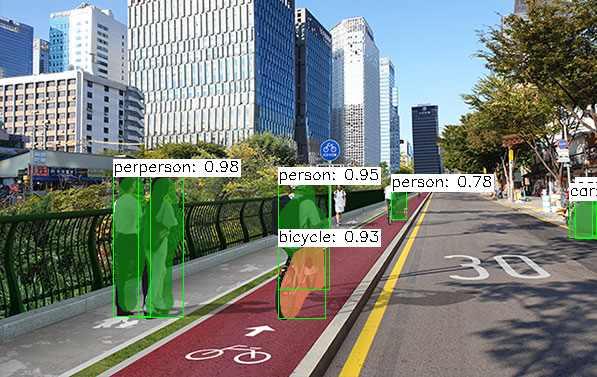

person: 0.99


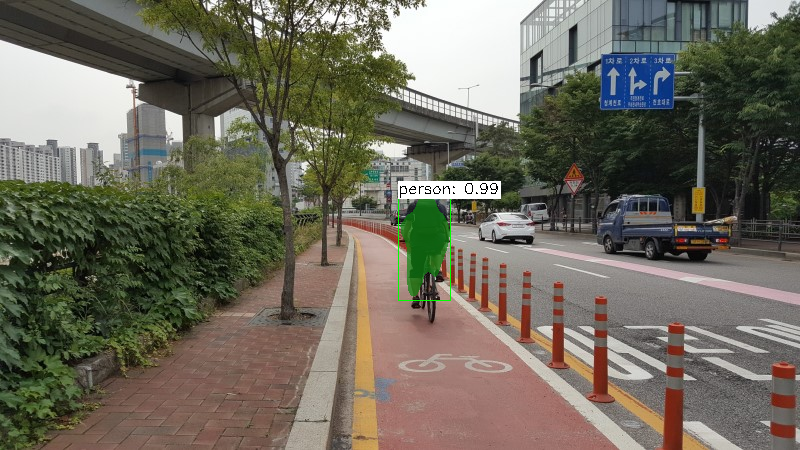

person: 0.99
car: 0.95


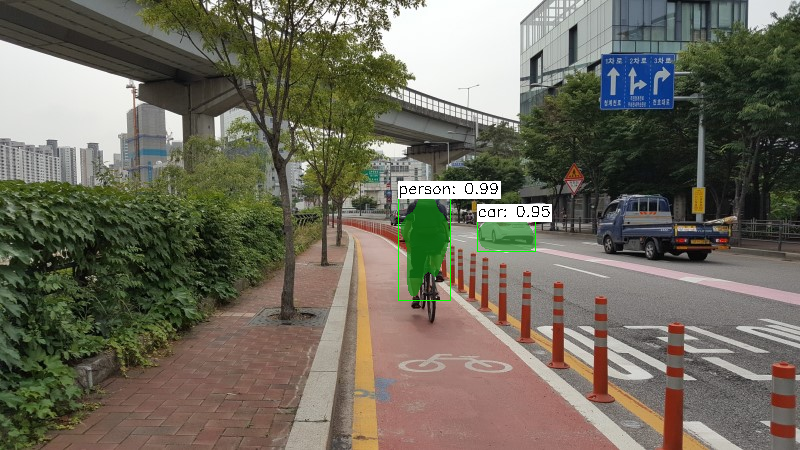

person: 0.99
car: 0.95
truck: 0.94


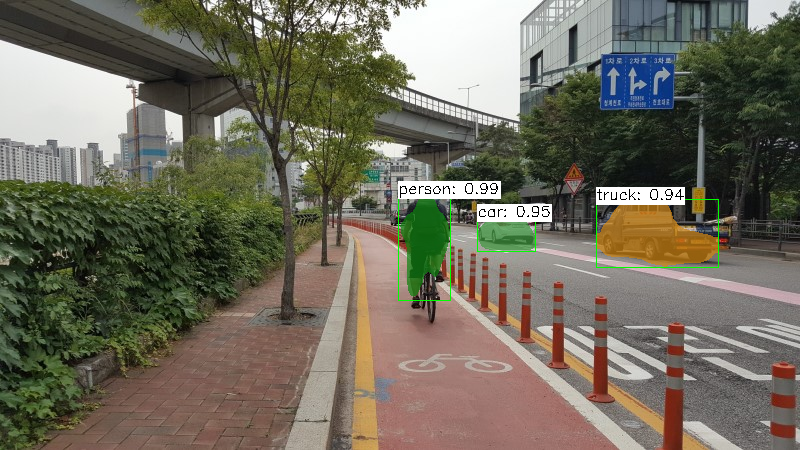

In [22]:
    # Input image
    #for i in range(1): ... # imgFile1, imgFile2, ...
    imgFiles =glob.glob("/content/drive/MyDrive/Colab Notebooks/road*.png")
    #imgFile = "person.jpg"
    #imgFile = "12283150_12d37e6389_z.jpg"
    #imgFile = "000000439715.jpg"
    for imgf_name in imgFiles:
        img = cv.imread(imgf_name)
        #cv2_imshow(img)
        # Load CNN model
        net = cv.dnn.readNet(model, config)
         # Run CNN: input image to output tensor
        blob = cv.dnn.blobFromImage(img, swapRB=1)
        net.setInput(blob)
        boxes, masks = net.forward(['detection_out_final', 'detection_masks'])
        boxesToDraw = []
        imgH, imgW, _ = img.shape
        numDetections = boxes.shape[2]
        for i in range(numDetections):
            box = boxes[0, 0, i]
            mask = masks[i]
            score = box[2]
            if score > TH1:
                classId = int(box[1])
                left = int(imgW * box[3])
                top = int(imgH * box[4])
                right = int(imgW * box[5])
                bottom = int(imgH * box[6])

                left = max(0, min(left, imgW - 1))
                top = max(0, min(top, imgH - 1))
                right = max(0, min(right, imgW - 1))
                bottom = max(0, min(bottom, imgH - 1))
                boxesToDraw.append([img, classId, score, left, top, right, bottom])

                classMask = mask[classId]
                classMask = cv.resize(classMask, (right - left + 1, bottom - top + 1))
                mask = (classMask > TH2)

                roi = img[top:bottom+1, left:right+1][mask]
                img[top:bottom+1, left:right+1][mask] = (0.7 * colors[classId] + 0.3 * roi).astype(np.uint8)
                for box in boxesToDraw:
                    drawBox(*box)
                cv2_imshow(img)